# E19 - SRGAN 활용하기

## 프로젝트 1 : 직접 고른 이미지로 SRGAN 실험하기

### 프로젝트 1-1

In [1]:
import cv2
import numpy as np
import tensorflow as tf
import os
import matplotlib.pyplot as plt

model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

(428, 640, 3)


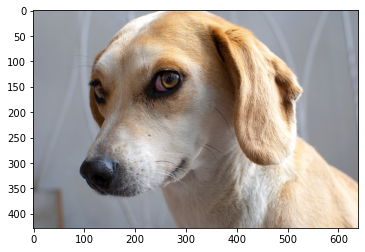

In [2]:
# 이미지 불러오기

image_path = os.getenv('HOME') + '/aiffel/super_resolution/dog.jpg'
img_hr = plt.imread(image_path)

print(img_hr.shape)

plt.imshow(img_hr)
plt.show()

(107, 160, 3)


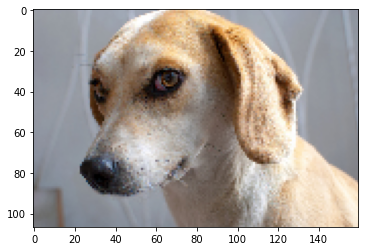

In [3]:
bicubic_img = cv2.resize(img_hr, dsize=(img_hr.shape[1]//4, img_hr.shape[0]//4),
                         interpolation=cv2.INTER_CUBIC)

print(bicubic_img.shape)

plt.imshow(bicubic_img)
plt.show()

In [4]:
# SRGAN으로 고해상도 이미지 생성하기

srgan_hr = apply_srgan(bicubic_img)

(428, 640, 3)


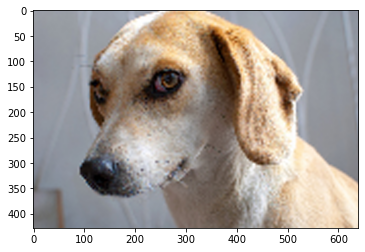

In [5]:
bicubic_up_img = cv2.resize(bicubic_img, dsize=(img_hr.shape[1], img_hr.shape[0]),
                            interpolation=cv2.INTER_CUBIC)

print(bicubic_up_img.shape)

plt.imshow(bicubic_up_img)
plt.show()

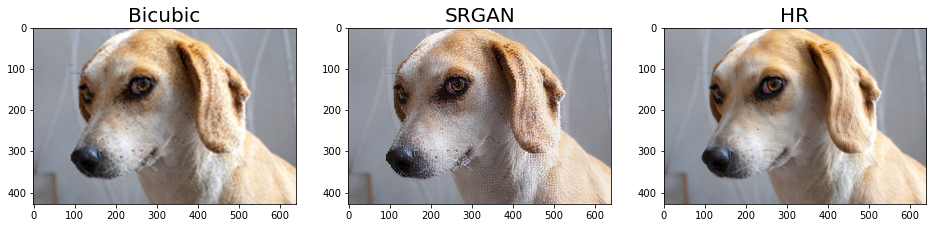

In [6]:
images = [bicubic_up_img, srgan_hr, img_hr]
titles = ['Bicubic', 'SRGAN', 'HR']

plt.figure(figsize=(16, 10))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.imshow(images[i])
    plt.title(titles[i], fontsize=20)

시각화 결과 bicubic interpolation보다 훨씬 더 선명해졌으나, 마치 노이즈가 낀 것처럼 보인다.   
SRGAN은 SRCNN 보다 더 깊은 신경망 구조를 사용했고, GAN 및 VGG 구조를 이용한 손실 함수를 사용한 모델이라 더 선명해진 것 같다.

### 프로젝트 1-2

(228, 300, 3)


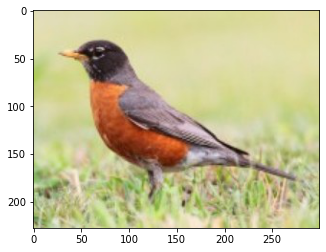

In [7]:
# 적당히 낮은 해상도의 이미지 불러오기

image_path = os.getenv('HOME') + '/aiffel/super_resolution/bird1.jpg'
img_hr = plt.imread(image_path)

print(img_hr.shape)

plt.imshow(img_hr)
plt.show()

In [8]:
srgan_hr = apply_srgan(img_hr)

(912, 1200, 3)


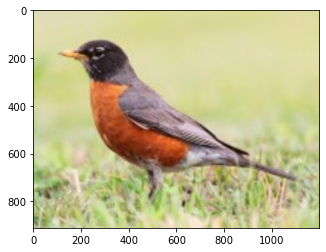

In [9]:
bicubic_up_img = cv2.resize(img_hr, dsize=(img_hr.shape[1]*4, img_hr.shape[0]*4),
                            interpolation=cv2.INTER_CUBIC)

print(bicubic_up_img.shape)

plt.imshow(bicubic_up_img)
plt.show()

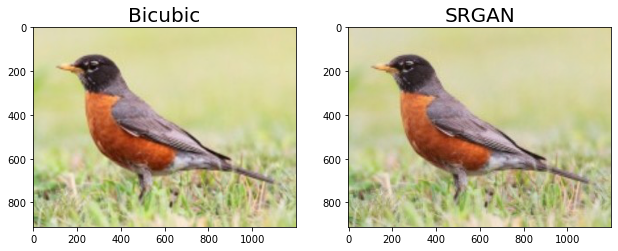

In [10]:
images = [bicubic_up_img, srgan_hr]
titles = ['Bicubic', 'SRGAN']

plt.figure(figsize=(16, 10))
for i in range(2):
    plt.subplot(1, 3, i + 1)
    plt.imshow(images[i])
    plt.title(titles[i], fontsize=20)

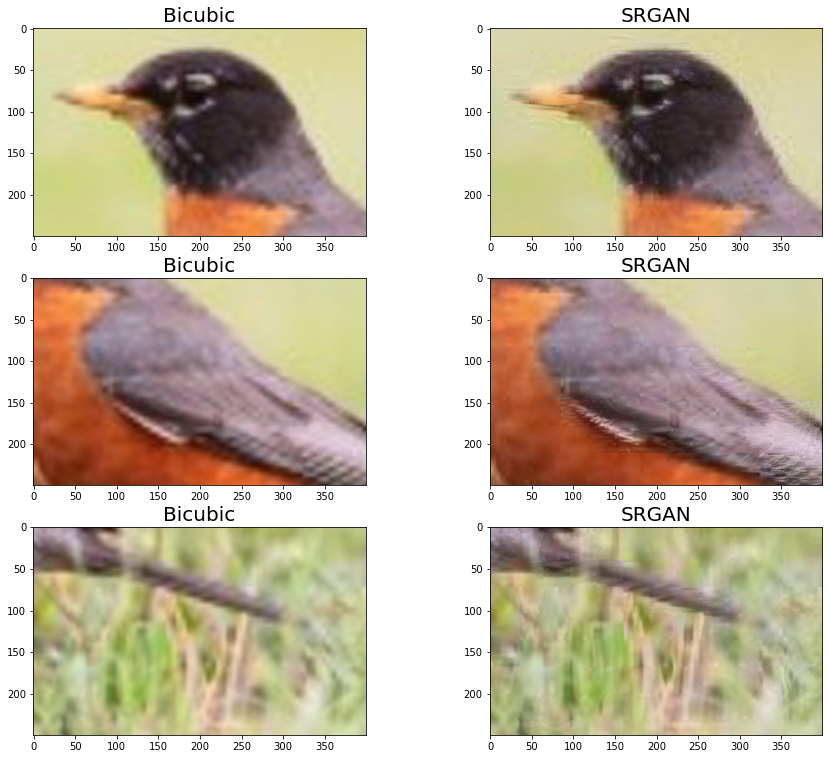

In [11]:
def crop(image, left_top, x=250, y=400):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

left_tops = [(100,80)] *2 + [(300,300)] *2 + [(600,800)] *2

plt.figure(figsize=(15, 13))
for i, (image, left_top, title) in enumerate(zip(images*3, left_tops, titles*3)):
    plt.subplot(3, 2, i+1)
    plt.imshow(crop(image, left_top))
    plt.title(title, fontsize=20)

SRGAN으로 생성된 이미지가 더 선명해진걸 확인할 수 있다.

## 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기

In [12]:
# gif 파일 불러오기

import cv2

gif_path = os.getenv('HOME') + '/aiffel/super_resolution/wine_lr.gif'
gif = cv2.VideoCapture(gif_path)

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 13
frame 크기 : (340, 355, 3)


In [13]:
# bicubic interpolation, srgan 적용하기

bicubic_frames_sr = []
srgan_frames_sr = []

for frame in frames:
    bicubic_frame = cv2.resize(frame, dsize=(frame.shape[1]*4, frame.shape[0]*4),
                             interpolation=cv2.INTER_CUBIC)
    bicubic_frames_sr.append(bicubic_frame)
    
    srgan_hr = apply_srgan(frame)
    srgan_frames_sr.append(srgan_hr)

In [14]:
import imageio

imageio.mimsave('wine_lr.gif', frames)
imageio.mimsave('bicubic_wine_hr.gif', bicubic_frames_sr)
imageio.mimsave('srgan_wine_hr.gif', srgan_frames_sr)

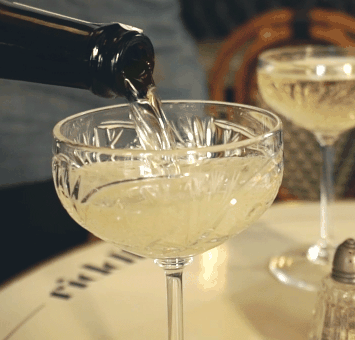

In [15]:
from IPython.display import Image as show_gif

show_gif('wine_lr.gif', width=600)

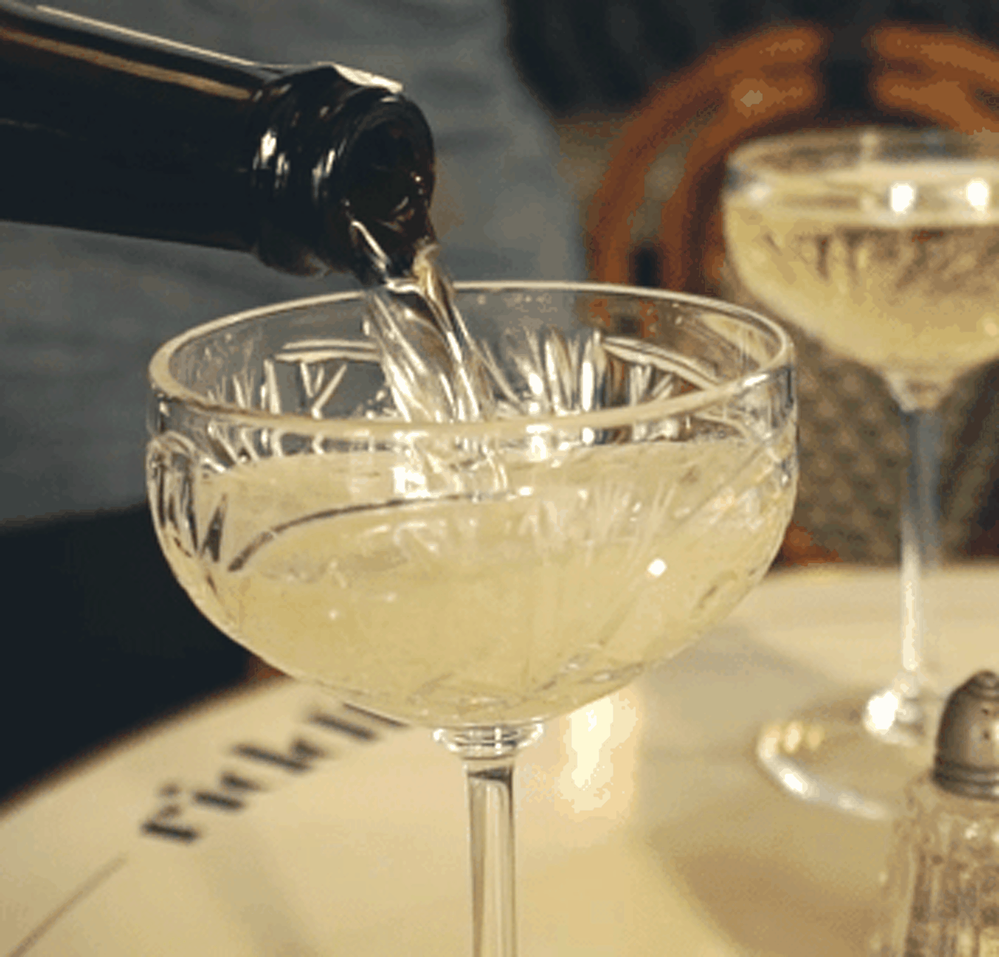

In [16]:
show_gif('bicubic_wine_hr.gif', width=600)

In [26]:
show_gif('srgan_wine_hr.gif', width=600)

srgan을 적용한 gif파일이 확실히 선명하게 보인다. 안경렌즈를 닦은 느낌??   
이런 super-resolution 기술이 더 발전하고 콤팩트해지면 실시간 영상에서 더 선명한 화질을 보여줄 것 같다.